I am making this separate Notebook to primarily track what exactly is being done by the Spatial Transformer Network (STN) present in the various models.

## Functions

First of all I define a few functions which will help us make the figures. These are inspired by the spatial transformer module in ggt.

In [1]:
import torch.nn as nn
import matplotlib.pyplot as plt
import matplotlib as mpl
import torch
import torchvision
import kornia.augmentation as K
from tqdm.notebook import tqdm

import numpy as np
import matplotlib.transforms as mtrans

#from ggt.visualization.spatial_transform import visualize_spatial_transform
from ggt.data import FITSDataset, get_data_loader
from ggt.models import model_factory
from ggt.utils import discover_devices, tensor_to_numpy

In [2]:
def visualize_spatial_transform(
    model,
    loader,
    output_dir,
    device="cpu",
    return_grids=False,
    matplotlib_backend="agg",
    data=None,
):

    # Turn off gradients
    with torch.no_grad():   
        
        if data is None:
            data = next(iter(loader))[0]
            
        data = data.to(device)

        # Bring the batch onto the CPU
        in_tensor = data.cpu()

        # Execute the predicted spatial transformation
        if hasattr(model, "spatial_transform"):
            out_tensor = model.spatial_transform(data).cpu()
        elif hasattr(model.module, "spatial_transform"):
            out_tensor = model.module.spatial_transform(data).cpu()
        else:
            raise ValueError("Model does not have a spatial_transform method")

            
        return in_tensor, out_tensor

In [3]:
def load_data(data_dir,slug,split,normalize=True,
                batch_size=36,channels=3,cutout_size=239,
                repeat_dims=True,label_col="bt",n_workers=2,
                shuffle=True):
    
    T_crop = nn.Sequential(K.CenterCrop(cutout_size))

    # Build a DataLoader to pull a batch from the desired split
    dataset = FITSDataset(
        data_dir=data_dir, slug=slug, normalize=normalize, split=split,
        cutout_size=cutout_size,channels=channels,repeat_dims=repeat_dims,
        label_col=label_col,transform=T_crop      
    )
    loader = get_data_loader(
        dataset, batch_size=batch_size, n_workers=n_workers,
        shuffle=shuffle
    )
    
    return loader

In [4]:
def print_grids(model_type,model_path,data_dir,output_dir,slug,split,
                return_grids=True,normalize=True, n_workers=2,
                batch_size=36,n_out=3,channels=3,cutout_size=239,
                parallel=True,repeat_dims=True,label_col="bt",
                loader=None,data=None):
    
    device = discover_devices()
    
    cls = model_factory(model_type)
    model_args = {
        "cutout_size": cutout_size,
        "channels": channels,
        "n_out": n_out,
    }

    if model_type == "vgg16_w_stn_drp":
        model_args["dropout"] = "True"

    model = cls(**model_args)
    model = nn.DataParallel(model) if parallel else model
    model = model.to(device)


    # Load the model from a saved state if provided
    model.load_state_dict(torch.load(model_path))
    
    if loader is None:
        loader = load_data(data_dir,slug,split,normalize,
                batch_size,channels,cutout_size,
                repeat_dims,label_col,n_workers)
    
    # Generate the visualizations
    in_tensor, out_tensor = visualize_spatial_transform(model, loader, output_dir, device = device,
                               return_grids=return_grids,data=data)
    
    return in_tensor,out_tensor

## Getting the matrix predicted for the transform

Since it seems from above that for many images we get almost a similar transformation, I am using a custom function to print out the predicted transformation matrix for the various images and seeing how much they differ.

In [5]:
activation = {}

#Function from https://discuss.pytorch.org/t/how-can-l-load-my-best-model-as-a-feature-extractor-evaluator/17254/5
#to register a forward hook and get activation
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

def load_model(model_path,model_type,parallel=True,cutout_size=239,
            channels=3,n_out=3):
    
    device = discover_devices()
    
    cls = model_factory(model_type)
    model_args = {
        "cutout_size": cutout_size,
        "channels": channels,
        "n_out": n_out,
    }

    model = cls(**model_args)
    model = nn.DataParallel(model) if parallel else model
    model = model.to(device)


    model.load_state_dict(torch.load(model_path))
    
    return model


def return_theta(input_data, model, parallel = True):

    #Since the fc_loc networks prints the elements of the theta matrix
    #we are trying to get the activation values of that layer for a given
    #input
    if parallel:
        model.module.fc_loc.register_forward_hook(get_activation('fc_loc'))
    else: 
        model.fc_loc.register_forward_hook(get_activation('fc_loc'))
        
        
    
    output = model(input_data)
    theta = activation['fc_loc']
    
    return theta
    #return theta.view(-1, 2, 3)
        
        
def theta_norms(theta_arr):
    
    theta_norms = []
    for theta in theta_arr:
        theta_norms.append(torch.norm(theta).item())
        
    return np.array(theta_norms)

**WARNING: The hook method how I have implemented above doesn't work properly in the DataParallel model unless the batch size is 1 (as in it's more complicated to collate the outputs from the two GPUs). Thus for now, DO NOT change the batch size**


Note that it's also pretty important to keep shuffle turned off as otherwise the order of everything gets messed up.

In [6]:
def load_data_2(data_dir,slug,split,normalize=True,
                batch_size=36,channels=3,cutout_size=239,
                repeat_dims=True,label_col="bt",n_workers=2,
                shuffle=False):
    
    T_crop = nn.Sequential(K.CenterCrop(cutout_size))

    # Build a DataLoader to pull a batch from the desired split
    dataset = FITSDataset(
        data_dir=data_dir, slug=slug, normalize=normalize, split=split,
        cutout_size=cutout_size,channels=channels,repeat_dims=repeat_dims,
        label_col=label_col,transform=T_crop      
    )
    loader = get_data_loader(
        dataset, batch_size=batch_size, n_workers=n_workers,
        shuffle=shuffle
    )
    
    return dataset, loader

def create_data_batch(dataset,idxs):
    
    arr = []

    for idx in idxs:
        arr.append(torch.unsqueeze(dataset[int(idx)][0],0))
        
    return torch.cat(arr)

Since finiding the least and most aggresive crops above was so useful, let's write up a function to do this. 

In [13]:
def show_least_and_most_aggresive_crops(data_dir,slug,split,label_col,cutout_size,
                                        model_path,model_type,parallel, channels, n_out,
                                        normalize,repeat_dims,n_workers=4,
                                        batch_size=36,logcolors=True):

    dataset, loader = load_data_2(data_dir,slug,split,normalize=normalize,
                batch_size=1,channels=channels,cutout_size=cutout_size,
                repeat_dims=repeat_dims,label_col=label_col,n_workers=n_workers,
                shuffle=False)


    theta_arr = []

    model = load_model(model_path=model_path,model_type=model_type,
                   parallel=parallel,cutout_size=cutout_size,
                   channels=channels,n_out=n_out)

    for batch in tqdm(loader):
        input_data = batch[0]
        theta_arr.append(return_theta(input_data,model,parallel=parallel))
    
    theta_norms_arr = theta_norms(theta_arr)
    sorted_idxs = np.argsort(theta_norms_arr)

    print("Lowest 2 and Highest 2 Theta Arrays")
    print(theta_arr[sorted_idxs[0]])
    print(theta_arr[sorted_idxs[1]])
    print(theta_arr[sorted_idxs[len(sorted_idxs)-1]])
    print(theta_arr[sorted_idxs[len(sorted_idxs)-2]])


    lowest_mag_data = create_data_batch(dataset,sorted_idxs[:5]) #by mag we are talking about norm of theta
    highest_mag_data = create_data_batch(dataset,sorted_idxs[-5:])


    output_dir = "/dev/null/"

    in_tensor_lowest,out_tensor_lowest = print_grids(model_type,model_path,data_dir,output_dir,slug,split,
                return_grids=True,normalize=normalize, n_workers=n_workers,
                batch_size=batch_size,n_out=n_out,channels=channels,cutout_size=cutout_size,
                parallel=parallel,repeat_dims=repeat_dims,label_col=label_col,
                loader=loader,data=lowest_mag_data)

    in_tensor_highest,out_tensor_highest = print_grids(model_type,model_path,data_dir,output_dir,slug,split,
                return_grids=True,normalize=normalize, n_workers=n_workers,
                batch_size=batch_size,n_out=n_out,channels=channels,cutout_size=cutout_size,
                parallel=parallel,repeat_dims=repeat_dims,label_col=label_col,
                loader=loader,data=highest_mag_data)


    fig, axes = plt.subplots(4,5,figsize=(20,14))
    ax = axes.flatten()

    for i in range(5):
        
        if logcolors:
            ax[i].imshow(in_tensor_lowest[i,0,:,:],norm=mpl.colors.LogNorm())
        else:
            ax[i].imshow(in_tensor_lowest[i,0,:,:])
        ax[i].set_xticks([])
        ax[i].set_yticks([])
    
        props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
        fontsize=12
    
        ax[i].text(0.05, 0.1,r'$\theta $ norm: %.4f' %(theta_norms_arr[sorted_idxs[i]]) ,transform=ax[i].transAxes, 
            fontsize=fontsize,verticalalignment='top', bbox=props)
    
        if logcolors:
            ax[i+5].imshow(out_tensor_lowest[i,0,:,:],norm=mpl.colors.LogNorm())
        else:
            ax[i+5].imshow(out_tensor_lowest[i,0,:,:])
        ax[i+5].set_xticks([])
        ax[i+5].set_yticks([])
    
    for i in range(10,15):
        if logcolors:
            ax[i].imshow(in_tensor_highest[i-10,0,:,:],norm=mpl.colors.LogNorm())
        else:
            ax[i].imshow(in_tensor_highest[i-10,0,:,:])
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        if logcolors:
            ax[i+5].imshow(out_tensor_highest[i-10,0,:,:],norm=mpl.colors.LogNorm())
        else:
            ax[i+5].imshow(out_tensor_highest[i-10,0,:,:])
        ax[i+5].set_xticks([])
        ax[i+5].set_yticks([])
    
        props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
        fontsize=12
    
        ax[i].text(0.05, 0.1,r'$\theta$ norm: %.4f' %(theta_norms_arr[sorted_idxs[len(sorted_idxs)-(i+1)]]) ,transform=ax[i].transAxes, 
            fontsize=fontsize,verticalalignment='top', bbox=props)



## ggt15 -- Models Trained Directly on the Real Galaxies

For each run in ggt15, below I plot what some of the transformations look like.

In the second plot, I also plot a subset of the galaxies where the cropping is more apparent/can be seen clearly.

### _1 -- VGG16wSTN 

In [5]:
in_tensor,out_tensor = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/dd777d17a0ee486ea9c3a4426a201209/artifacts/ggt15-balanced-xl-dd777d17a0ee486ea9c3a4426a201209.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36)

[2021-08-20 01:01:35,187] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cbfc5258>
[2021-08-20 01:01:41,306] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 60214.54it/s]
[2021-08-20 01:01:41,326] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:01<00:00, 816.78it/s]


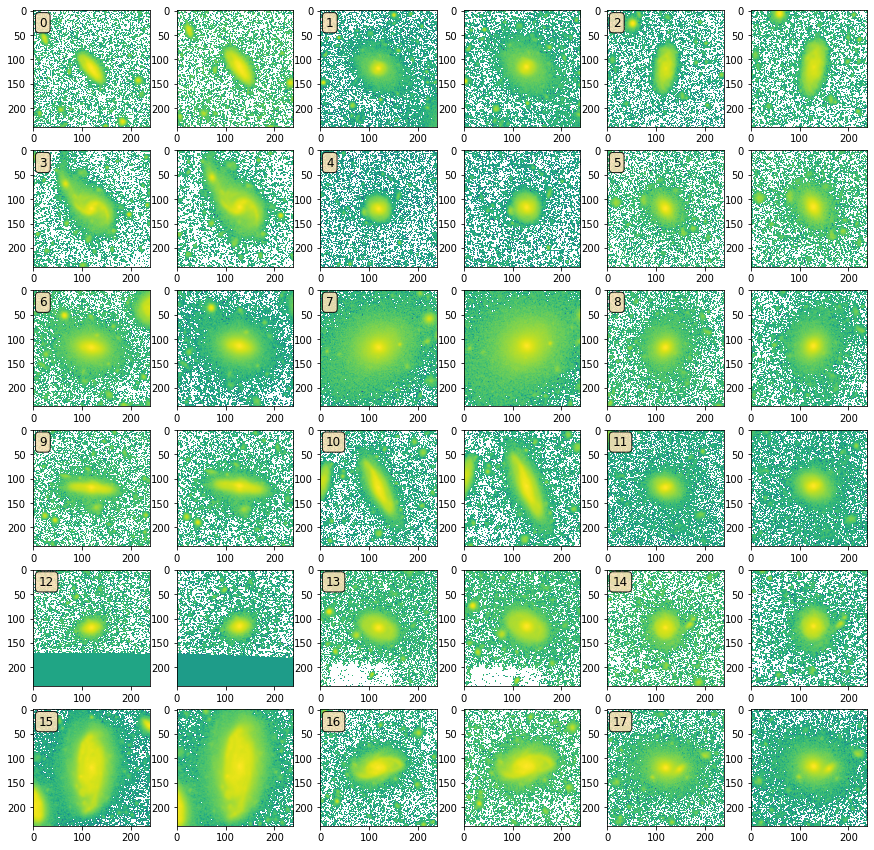

In [6]:
fig, ax = plt.subplots(6,6,figsize=(15,15))

ax = ax.flatten()
j = 0

for i in range(0,int(len(ax)/2.0)):
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.9)
    ax[j].text(0.05, 0.95,i,transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

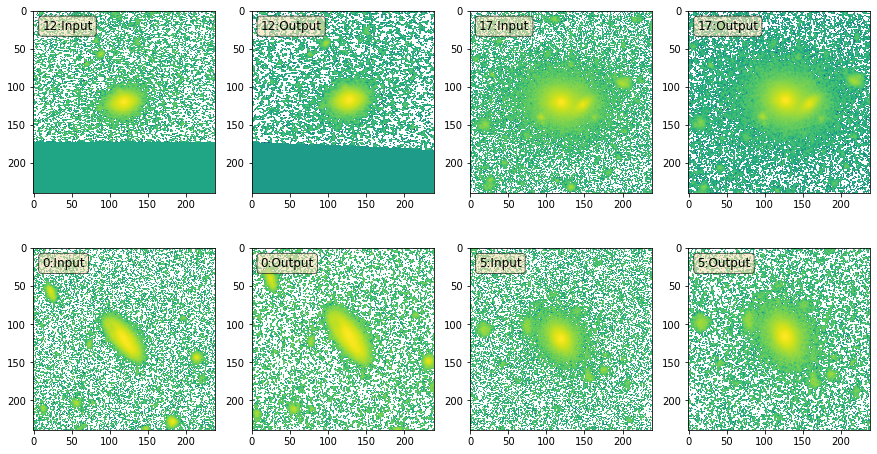

In [7]:
indexes_to_print_again = [12,17,0,5]

fig, ax = plt.subplots(2,4,figsize=(15,8))

ax = ax.flatten()
j = 0

for i in indexes_to_print_again:
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    ax[j].text(0.05, 0.95,str(i) + ":Input",transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    ax[j+1].text(0.05, 0.95,str(i) + ":Output",transform=ax[j+1].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

### _3 --> VGG16wSTN predicting only bt

In [8]:
in_tensor,out_tensor = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/6baa68cc82094740bcf7ad2372ff6aed/artifacts/ggt15-balanced-xl-6baa68cc82094740bcf7ad2372ff6aed.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=1)

[2021-08-20 01:01:48,656] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af452db8048>
[2021-08-20 01:01:51,212] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 63811.11it/s]
[2021-08-20 01:01:51,230] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 2395.90it/s]


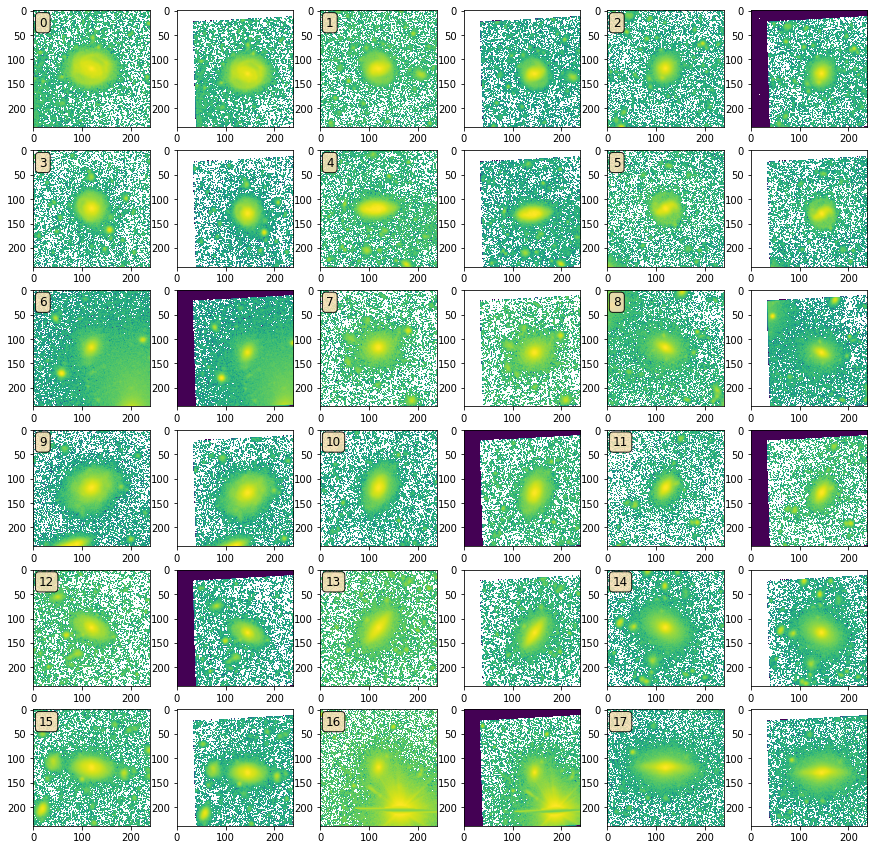

In [9]:
fig, ax = plt.subplots(6,6,figsize=(15,15))

ax = ax.flatten()
j = 0

for i in range(0,int(len(ax)/2.0)):
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.9)
    ax[j].text(0.05, 0.95,i,transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

### _2 --> GGT

In [25]:
in_tensor,out_tensor = print_grids(model_type="ggt",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/49cc1ff94d7c43d68a374bb87b0d6ea4/artifacts/ggt15-balanced-xl-49cc1ff94d7c43d68a374bb87b0d6ea4.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=False,channels=1,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=3)

[2021-08-20 01:07:22,554] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cbfc57d8>
[2021-08-20 01:07:23,112] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 63948.28it/s]
[2021-08-20 01:07:23,130] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:01<00:00, 804.50it/s]


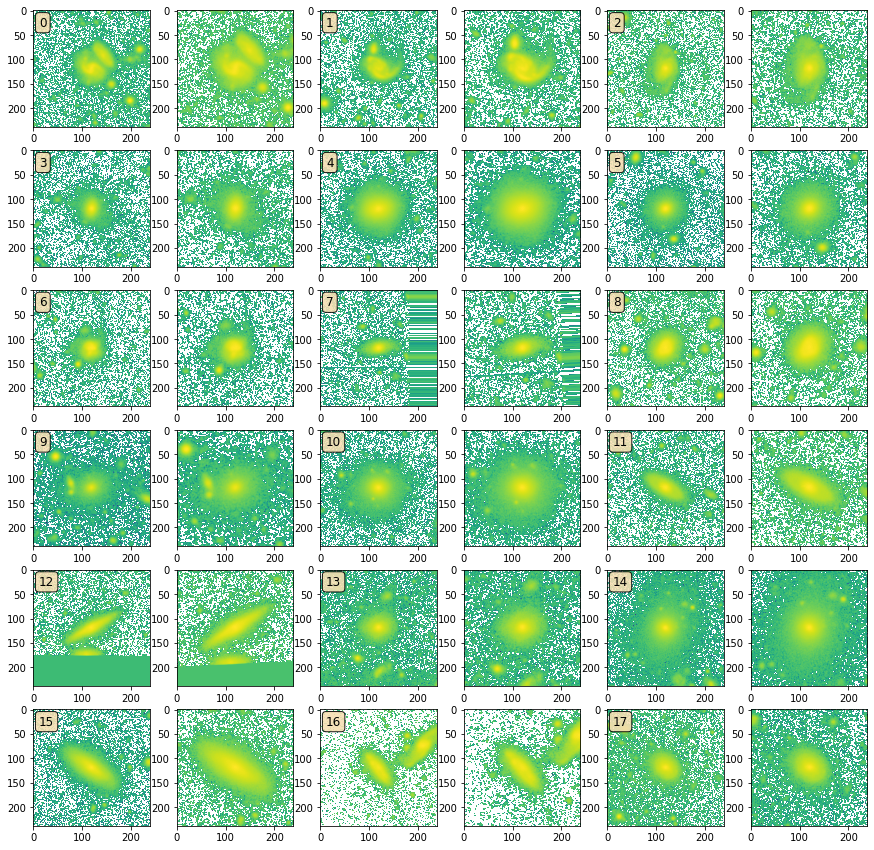

In [26]:
fig, ax = plt.subplots(6,6,figsize=(15,15))

ax = ax.flatten()
j = 0

for i in range(0,int(len(ax)/2.0)):
    try:
        ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
        ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    except ValueError:
        ax[j].imshow(in_tensor[i,0,:,:])
        ax[j+1].imshow(out_tensor[i,0,:,:])
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.9)
    ax[j].text(0.05, 0.95,i,transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

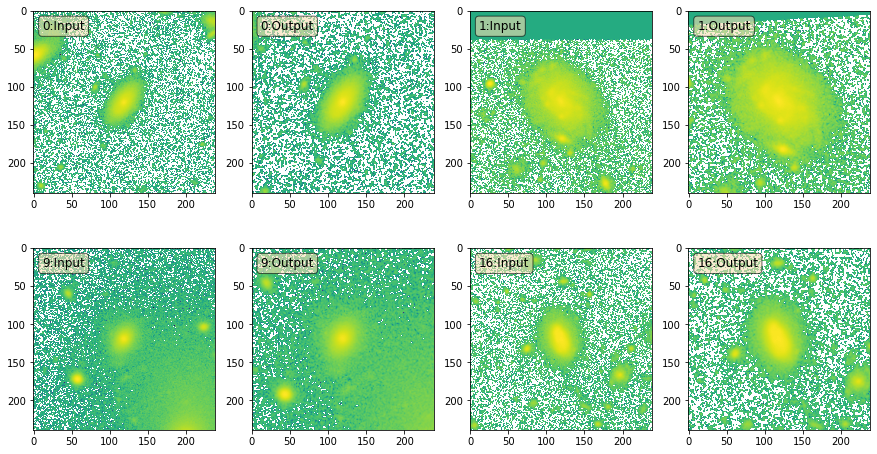

In [12]:
indexes_to_print_again = [0,1,9,16]

fig, ax = plt.subplots(2,4,figsize=(15,8))

ax = ax.flatten()
j = 0

for i in indexes_to_print_again:
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    ax[j].text(0.05, 0.95,str(i) + ":Input",transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    ax[j+1].text(0.05, 0.95,str(i) + ":Output",transform=ax[j+1].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

### _4 -- GGT predicting only bt

In [13]:
in_tensor,out_tensor = print_grids(model_type="ggt",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/1f88af757b864346b71fe955320a0203/artifacts/ggt15-balanced-xl-1f88af757b864346b71fe955320a0203.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=False,channels=1,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=1)

[2021-08-20 01:02:02,002] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cee82c50>
[2021-08-20 01:02:02,588] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 63564.51it/s]
[2021-08-20 01:02:02,606] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 2171.06it/s]


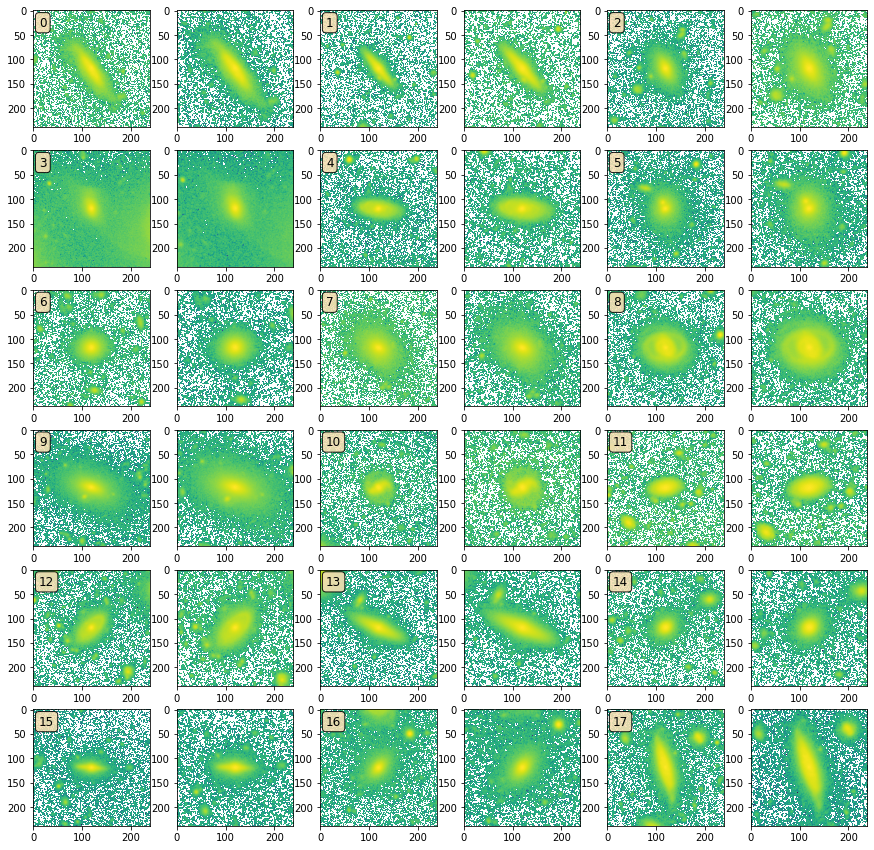

In [14]:
fig, ax = plt.subplots(6,6,figsize=(15,15))

ax = ax.flatten()
j = 0

for i in range(0,int(len(ax)/2.0)):
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.9)
    ax[j].text(0.05, 0.95,i,transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

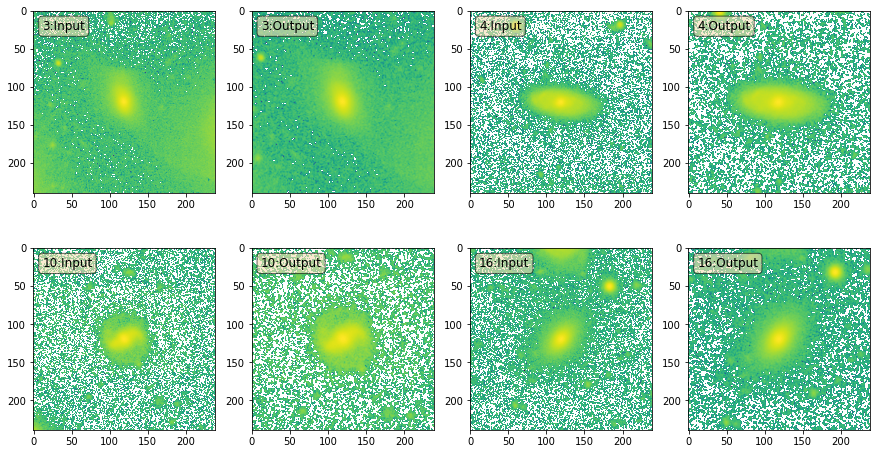

In [15]:
indexes_to_print_again = [3,4,10,16]

fig, ax = plt.subplots(2,4,figsize=(15,8))

ax = ax.flatten()
j = 0

for i in indexes_to_print_again:
    ax[j].imshow(in_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+1].imshow(out_tensor[i,0,:,:],norm=mpl.colors.LogNorm())
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    ax[j].text(0.05, 0.95,str(i) + ":Input",transform=ax[j].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    ax[j+1].text(0.05, 0.95,str(i) + ":Output",transform=ax[j+1].transAxes, 
        fontsize=12,verticalalignment='top', bbox=props)
    
    j+=2

## Comparing Different Runs

Now, in order to compare the different types of transformations that the different models do, it's useful to see these transformations in action applied to the same galaxies.

Thus, I use the trick below with shuffle turned off, which ensures we load the same data and then feed it through each model to visualize the output of the STN.

In [50]:
data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/"
slug="balanced-xl"
split="devel"


rep_chnl_loader = load_data(data_dir,slug,split,normalize=True,
                batch_size=36,channels=3,cutout_size=239,
                repeat_dims=True,label_col="(B/T)g",n_workers=2,
                shuffle=False)

rep_chnl_data = next(iter(rep_chnl_loader))[0]

sngl_chnl_loader = load_data(data_dir,slug,split,normalize=True,
                batch_size=36,channels=1,cutout_size=239,
                repeat_dims=False,label_col="(B/T)g",n_workers=2,
                shuffle=False)

sngl_chnl_data = next(iter(sngl_chnl_loader))[0]

[2021-08-20 01:44:56,224] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 61720.88it/s]
[2021-08-20 01:44:56,242] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 1016.68it/s]
[2021-08-20 01:44:58,520] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 59572.26it/s]
[2021-08-20 01:44:58,539] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 2223.23it/s]


In [17]:
in_tensor_1,out_tensor_1 = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/dd777d17a0ee486ea9c3a4426a201209/artifacts/ggt15-balanced-xl-dd777d17a0ee486ea9c3a4426a201209.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36,loader=rep_chnl_loader,data=rep_chnl_data)

[2021-08-20 01:02:12,411] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af501036ba0>


In [21]:
in_tensor_2,out_tensor_2 = print_grids(model_type="ggt",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/49cc1ff94d7c43d68a374bb87b0d6ea4/artifacts/ggt15-balanced-xl-49cc1ff94d7c43d68a374bb87b0d6ea4.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=False,channels=1,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=3,loader=sngl_chnl_loader,data=sngl_chnl_data)

[2021-08-20 01:02:21,578] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cf42e570>


In [31]:
in_tensor_3,out_tensor_3 = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/6baa68cc82094740bcf7ad2372ff6aed/artifacts/ggt15-balanced-xl-6baa68cc82094740bcf7ad2372ff6aed.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=1,loader=rep_chnl_loader,data=rep_chnl_data)

[2021-08-20 01:09:13,865] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af5038ac258>


In [23]:
in_tensor_4,out_tensor_4 = print_grids(model_type="ggt",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/1f88af757b864346b71fe955320a0203/artifacts/ggt15-balanced-xl-1f88af757b864346b71fe955320a0203.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=False,channels=1,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=1,loader=sngl_chnl_loader,data=sngl_chnl_data)

[2021-08-20 01:02:25,940] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cee82db0>


In [77]:
in_tensor_5,out_tensor_5 = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/17/df896108e22847f5ae4e49c48d7367c4/artifacts/ggt13-balanced-xl-df896108e22847f5ae4e49c48d7367c4.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=3,loader=rep_chnl_loader,data=rep_chnl_data)

[2021-08-20 03:12:38,222] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af4cf9cb200>


In [80]:
in_tensor_6,out_tensor_6 = print_grids(model_type="vgg16_w_stn",model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/15/241bbdf87f6e4a22bd321aeff2987c1a/artifacts/ggt11-balanced-dev-241bbdf87f6e4a22bd321aeff2987c1a.pt",
           data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/",
           output_dir="/home/ag2422/scratch",slug="balanced-xl",split="devel",repeat_dims=True,channels=3,
           label_col="(B/T)g",return_grids=True,batch_size=36,n_out=3,loader=rep_chnl_loader,data=rep_chnl_data)

[2021-08-20 03:32:21,534] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2af500fee6d0>


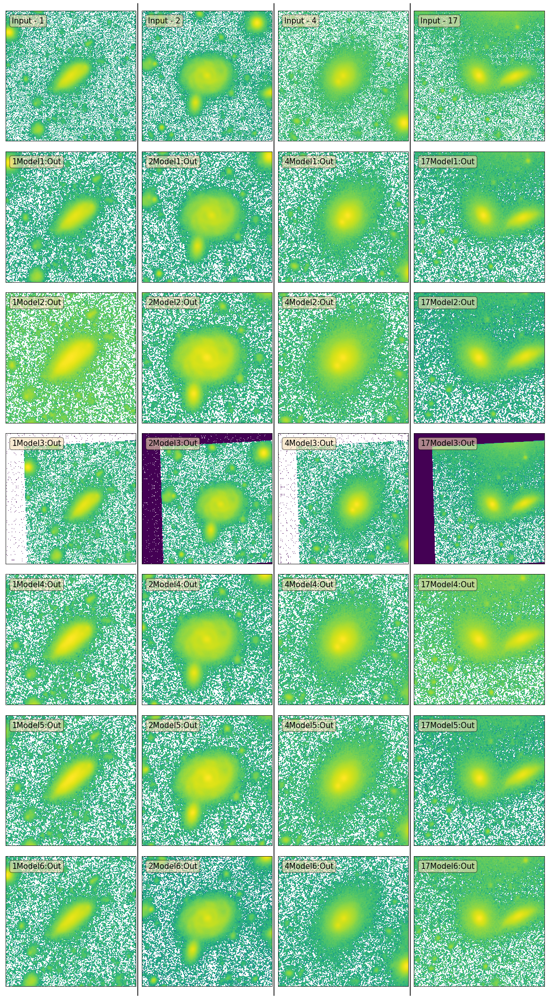

In [82]:
fig, axes = plt.subplots(7,4,figsize=(15,27))
indexes_to_print_again = [1,2,4,17]


ax = axes.flatten()
j = 0

for i in indexes_to_print_again:
    
    ax[j].imshow(in_tensor_1[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j].set_xticks([])
    ax[j].set_yticks([])
    ax[j+4].imshow(out_tensor_1[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+4].set_xticks([])
    ax[j+4].set_yticks([])
    ax[j+8].imshow(out_tensor_2[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+8].set_xticks([])
    ax[j+8].set_yticks([])
    ax[j+12].imshow(out_tensor_3[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+12].set_xticks([])
    ax[j+12].set_yticks([])
    ax[j+16].imshow(out_tensor_4[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+16].set_xticks([])
    ax[j+16].set_yticks([])
    ax[j+20].imshow(out_tensor_5[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+20].set_xticks([])
    ax[j+20].set_yticks([])
    ax[j+24].imshow(out_tensor_6[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[j+24].set_xticks([])
    ax[j+24].set_yticks([])
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    fontsize=15
    ax[j].text(0.05, 0.95,"Input - " + str(i) ,transform=ax[j].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+4].text(0.05, 0.95,str(i) + "Model1:Out",transform=ax[j+4].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+8].text(0.05, 0.95,str(i) + "Model2:Out",transform=ax[j+8].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+12].text(0.05, 0.95,str(i) + "Model3:Out",transform=ax[j+12].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+16].text(0.05, 0.95,str(i) + "Model4:Out",transform=ax[j+16].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+20].text(0.05, 0.95,str(i) + "Model5:Out",transform=ax[j+20].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[j+24].text(0.05, 0.95,str(i) + "Model6:Out",transform=ax[j+24].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    
    j+=1
    

#Code to draw verticl lines in the figure
    
# rearange the axes for no overlap
fig.tight_layout()

# Get the bounding boxes of the axes including text decorations
r = fig.canvas.get_renderer()
get_bbox = lambda ax: ax.get_tightbbox(r).transformed(fig.transFigure.inverted())
bboxes = np.array(list(map(get_bbox, axes.flat)), mtrans.Bbox).reshape(axes.shape)

#Get the minimum and maximum extent, get the coordinate half-way between those
xmax = np.array(list(map(lambda b: b.x1, bboxes.flat))).reshape(axes.shape).max(axis=0)
xmin = np.array(list(map(lambda b: b.x0, bboxes.flat))).reshape(axes.shape).min(axis=0)
xs = np.c_[xmax[1:], xmin[:-1]].mean(axis=1)

# Draw a horizontal lines at those coordinates
for x in xs:
    line = plt.Line2D([x,x],[0,1], transform=fig.transFigure, color="black")
    fig.add_artist(line)


plt.show()

* Model 1 (ggt15_1): VGG 16 w STN directly trained on real data
* Model 2 (ggt15_2): GGT directly trained on real data
* Model 3 (ggt15_3): VGG 16 w STN directly trained on real data predicting only BT
* Model 4 (ggt15_4): GGT directly trained on real data predicting only BT
----------
* Model 5 (ggt13_2): VGG16 w STN first trained on sims and then TL on real data
----------
* Model 6 (ggt11_3): VGG 16 w STN trained only on sims

Model's 3's transformations are wierd. These are also in line with the fact Model 3 inherently didn't converge as well as some of the other models

* **Does predicting only BT help in the STN make more aggresive transformations?**

Ans: No, by comparing the outputs of Model 2 and Model 4, it's pretty clear that predicting only BTR doesn't seem to help with the STN making more aggresive transforamtions.

* **Does GGT make more aggresive transformations than VGG?**'

Ans: No, simply a comparison of Model 5 and Model 4 above tells us that overall GGT doesn't always make more aggressive transformations that VGG


* **Does training on the real data make more aggresive transformations compared to sim + real data?**

Ans: No. The model trained on Sim + Real data (model 5) in fact for the above figures, does a slightly better job compared the model trained directly only on real data (model 1).

The one trained only on sims (model 6) also doesn't do a worse job than the one trained directly on real data (mdoel 1)

**Overall Conclusions**

Our model trained on sims + TL-ed on real data (model 5) does a good job. I had tried a variety of different things to see whether those lead to more aggressive cuts. But they don't. 

In fact when I see these cuts in bigger sizes; they seem reasonable. The STN of course doesn't make more aggressive cuts that this because this would lead to the acutal galaxies being cropped off.

**Questions for Amrit**:-
* What do you think based on these results?
* Is there any way to make the STN not make the exact same transformation on all the images? (wasn't the point it does different transformations for different images; or do I have it wrong?)

### Model 5 above (ggt13_2)

Let's load the model and the data corresponding to Model 5 above (ggt13_2)

After loading the mode, we use the above defined functions to get the thetas predicted by our spatial transformer network.

**What is the $\theta$?**

Ans: The localization network inside the STN produces a matrix containing all the parameters of the transformation that is going to be applied. This matrix is referred to by theta. Since we are doing an affine transformation we get a matrix with two rows and three columns (i.e. elements).

$$
\left(\begin{array}{c}
x_{i}^{s} \\
y_{i}^{s}
\end{array}\right)=\mathcal{T}_{\theta}\left(G_{i}\right)=\mathrm{A}_{\theta}\left(\begin{array}{c}
x_{i}^{t} \\
y_{i}^{t} \\
1
\end{array}\right)=\left[\begin{array}{lll}
\theta_{11} & \theta_{12} & \theta_{13} \\
\theta_{21} & \theta_{22} & \theta_{23}
\end{array}\right]\left(\begin{array}{c}
x_{i}^{t} \\
y_{i}^{t} \\
1
\end{array}\right)
$$

Now, $\theta_{11}$ and $\theta_{22}$ are the two parameters that control the amount of the crop. If these are one (and all other elements are zero) then that means that it's an identity transformation. However, if these are say 0.8 (and all other elements are zero), then only 20% of the image is cropped out. Thus, higher this number, lower is the amount of crop.

Therefore, if we take the norm of the matrix $\theta$, then higher the norm, the less aggressive will be the crop.

In [7]:
data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/"
slug="balanced-xl"
split="devel"

dataset, loader = load_data_2(data_dir,slug,split,label_col="(B/T)g",batch_size=1,
                             shuffle=False)


#Doing for ggt13_2 (model5 above)
model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/17/df896108e22847f5ae4e49c48d7367c4/artifacts/ggt13-balanced-xl-df896108e22847f5ae4e49c48d7367c4.pt"
model_type="vgg16_w_stn"
parallel=True

theta_arr = []

model = load_model(model_path,model_type,parallel=parallel)

for batch in tqdm(loader):
    input_data = batch[0]
    theta_arr.append(return_theta(input_data,model,parallel=parallel))

[2021-09-08 17:05:10,931] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 79375.94it/s]
[2021-09-08 17:05:10,947] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:02<00:00, 346.20it/s]
[2021-09-08 17:05:14,013] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b0b626029e8>


Now, let's calculate the norms of these thetas; and try to sort them. We expect that higher the norm, the more aggresive the predicted tansformation to be. 

We figure out the galaxies for which the STN does the least and the most aggresive cropping.

In [8]:
theta_norms_arr = theta_norms(theta_arr)
sorted_idxs = np.argsort(theta_norms_arr)
print(sorted_idxs[:5])
print(sorted_idxs[-5:])

[274 756 949 368 609]
[835 940 884 694 729]


In [9]:
lowest_mag_data = create_data_batch(dataset,[274,756,949,368,609]) #by mag we are talking about norm of theta
highest_mag_data = create_data_batch(dataset,[835,940,884,694,729])

In [10]:
output_dir = "/home/ag2422/scratch"
in_tensor_lowest,out_tensor_lowest = print_grids(model_type,model_path,data_dir,output_dir,slug,split,
                return_grids=True,normalize=True, n_workers=2,
                batch_size=36,n_out=3,channels=3,cutout_size=239,
                parallel=True,repeat_dims=True,label_col="(B/T)g",
                loader=loader,data=lowest_mag_data)
in_tensor_highest,out_tensor_highest = print_grids(model_type,model_path,data_dir,output_dir,slug,split,
                return_grids=True,normalize=True, n_workers=2,
                batch_size=36,n_out=3,channels=3,cutout_size=239,
                parallel=True,repeat_dims=True,label_col="(B/T)g",
                loader=loader,data=highest_mag_data)

[2021-09-08 17:05:33,420] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b0b62602150>
[2021-09-08 17:05:34,951] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b0b62602150>


Below, we visualize the transformations on the galaxies with the **lowest values of norm. of theta** (most aggressive crop)

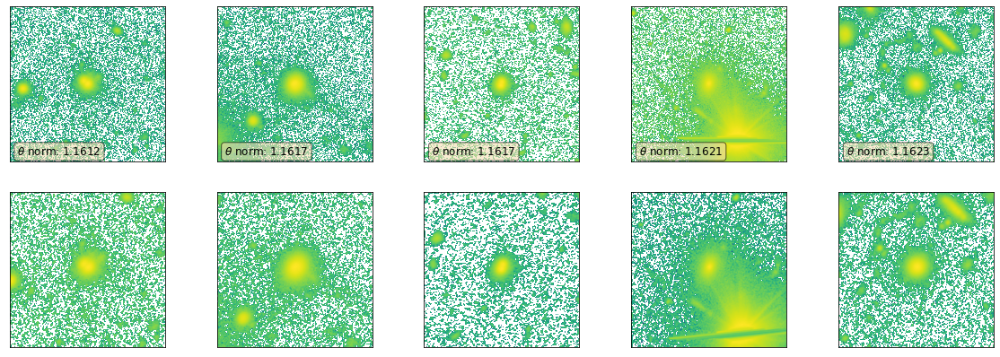

In [11]:
fig, axes = plt.subplots(2,5,figsize=(20,7))

ax = axes.flatten()
j = 0

for i in range(5):
    ax[i].imshow(in_tensor_lowest[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    fontsize=12
    
    ax[i].text(0.05, 0.1,r'$\theta $ norm: %.4f' %(theta_norms_arr[sorted_idxs[i]]) ,transform=ax[i].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)
    
    ax[i+5].imshow(out_tensor_lowest[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[i+5].set_xticks([])
    ax[i+5].set_yticks([])

Below, I show the galaxies with the **highest values of the norm of theta (i.e. least aggressive crops)**

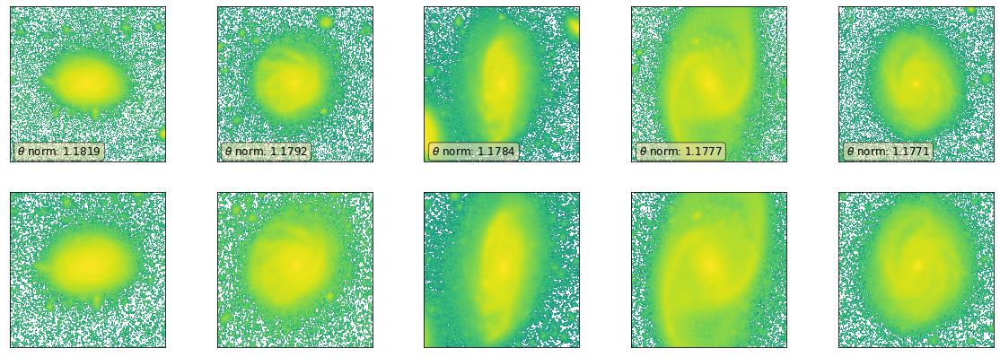

In [12]:
fig, axes = plt.subplots(2,5,figsize=(20,7))

ax = axes.flatten()
j = 0

for i in range(5):
    ax[i].imshow(in_tensor_highest[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i+5].imshow(out_tensor_highest[i,0,:,:],norm=mpl.colors.LogNorm())
    ax[i+5].set_xticks([])
    ax[i+5].set_yticks([])
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
    fontsize=12
    
    ax[i].text(0.05, 0.1,r'$\theta$ norm: %.4f' %(theta_norms_arr[sorted_idxs[len(sorted_idxs)-(i+1)]]) ,transform=ax[i].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)

**As expected, the least aggresive crop is applied on the largest galaxies and the most aggresive crops is applied on the smallest galaxies. However, the difference between the amount of these crops is not very apprent.**

So, we make the plot below to test this out. Here we take the galaxy on which the most aggressive crop was applied, and then compare that crop with the least aggressive crop in the entire dataset.

[2021-09-08 17:25:27,516] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b0b8e95f8e0>


Text(0.05, 0.18, 'Least Aggressive Crop \n(applied to a large galaxy)')

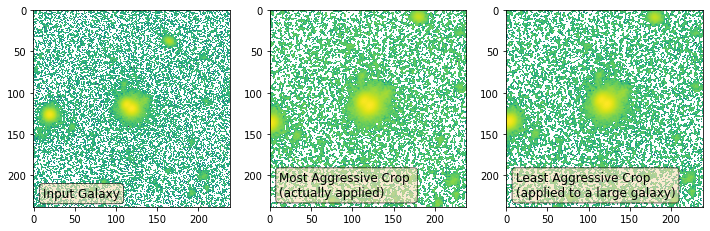

In [33]:
import torch.nn.functional as F

device = discover_devices()
in_tensor_lowest = in_tensor_lowest.to(device)

theta_lowest = theta_arr[274].view(-1, 2, 3).to(device)
theta_highest = theta_arr[729].view(-1, 2, 3).to(device)

grid_lowest = F.affine_grid(theta_lowest, in_tensor_lowest[0,:,:,:].unsqueeze(0).size(), align_corners=True)
output_lowest = F.grid_sample(in_tensor_lowest[0,:,:,:].unsqueeze(0), grid_lowest, align_corners=True)

grid_highest = F.affine_grid(theta_highest, in_tensor_lowest[0,:,:,:].unsqueeze(0).size(), align_corners=True)
output_highest = F.grid_sample(in_tensor_lowest[0,:,:,:].unsqueeze(0), grid_highest, align_corners=True)

output_highest = output_highest.cpu()
output_lowest = output_lowest.cpu()

fig, axes = plt.subplots(1,3,figsize=(12,4))

ax = axes.flatten()

ax[0].imshow(in_tensor_lowest[0,0,:,:].cpu(),norm=mpl.colors.LogNorm())
ax[1].imshow(output_lowest[0,0,:,:],norm=mpl.colors.LogNorm())
ax[2].imshow(output_highest[0,0,:,:],norm=mpl.colors.LogNorm())

props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)
fontsize=12
    
ax[0].text(0.05, 0.1, "Input Galaxy" ,transform=ax[0].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)

ax[1].text(0.05, 0.18, "Most Aggressive Crop \n(actually applied)" ,transform=ax[1].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)

ax[2].text(0.05, 0.18, "Least Aggressive Crop \n(applied to a large galaxy)" ,transform=ax[2].transAxes, 
        fontsize=fontsize,verticalalignment='top', bbox=props)

**So, overall we do see crops being applied on the galaxies. And systematically more aggressive crops are applied on smaller galaxies compared to less aggressive crops on larger galaxies. However, the problem is that the difference between the least and the most aggressive crop is not that much** 

**What is the reason that you are not getting more aggresive crops and what could be some ideas to address this?**

1) Since Amrit was able to achieve more aggressive crops with a different dataset, could it be that if we remove that larger galaxies from training the network learns to make much more aggresive crops? Because remember downstream for classification that galaxies are going to be passed through the same set of filters; so putting a small galaxy over a very large portion of the input image might not be ideal for a dataset where there are large galaxies present as well. 

2) [DONE] Could we start the training from a non-identity transformation i.e. with 0.8 for $\theta_{11,22}$?

3) Could it be that the sturcture of our localization network is not complex enough for the network to produce varied enough thetas for different images. Could changing the number of layers in the localization network or changing the localization network to a network with convolutional layers (instead of FC layers only) help? (Appendix A.4 of the Jaderbreg paper has some details about what they did)

4) Try to recreate Amirt's super aggresive cropping network?

5) Are we sure that the weights of the FCN that predicts theta mostly stop changing (i.e. they are "trained" by the time we finish training for rest of the network)? Although super bad weights should show up automatically in the downstream accuracy/loss anyway. 

Since finiding the least and most aggresive crops above was so useful, let's write up a function to do this. 

## Initializing the Run with $\theta_{11,22}$ = 0.8 (ggt15_5)

One idea above was to check if anything interesting happens when we change the initialization of the $\theta_{11,22}$ parameters. To do this we trained a CNN with a STN-VGG16 model directly on the real galaxies. 

Now, let's see how much that changes anything. 

[2021-09-22 15:49:20,733] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 61115.62it/s]
[2021-09-22 15:49:20,752] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 2308.51it/s]
[2021-09-22 15:49:24,328] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59497694c0>


[2021-09-22 15:49:34,592] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59497694c0>



Lowest 2 and Highest 2 Theta Arrays
tensor([[ 0.7880, -0.1076, -0.0357,  0.0882,  0.8384,  0.0016]],
       device='cuda:0')
tensor([[ 7.9623e-01, -1.0129e-01, -3.5069e-02,  8.8492e-02,  8.4384e-01,
          3.3329e-04]], device='cuda:0')
tensor([[ 8.5214e-01, -7.8937e-02, -3.6943e-02,  9.2027e-02,  8.9396e-01,
         -3.7301e-04]], device='cuda:0')
tensor([[ 8.5042e-01, -7.9947e-02, -3.6571e-02,  9.1928e-02,  8.9269e-01,
         -4.3074e-04]], device='cuda:0')


[2021-09-22 15:49:36,281] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59497694c0>


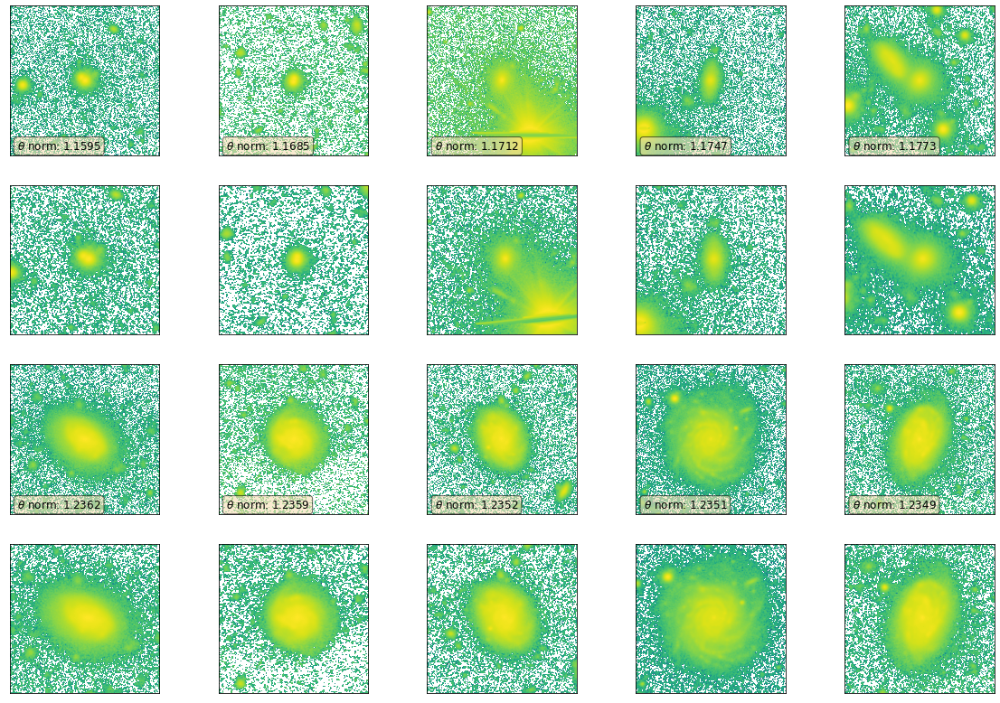

In [92]:
data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/"
model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/93d140201a224b51b5b0a79a1f8ff8aa/artifacts/ggt15-balanced-xl-93d140201a224b51b5b0a79a1f8ff8aa.pt"
model_type="vgg16_w_stn"

show_least_and_most_aggresive_crops(data_dir=data_dir,slug="balanced-xl",split="devel",label_col="(B/T)g",cutout_size=239,
                                    model_path=model_path,model_type=model_type,parallel=True, channels=3, n_out=3,
                                    normalize=True,repeat_dims=True,n_workers=4,batch_size=36)

**It is clear from the printed values of theta above as well as the figures plotted just below; that just initializing the values from 0.8 doesn't mean that they will reduce all the way down to 0.6 or something** (Thus initializing from 0.8 is not the solution)

# ggt16b runs 

I had initiated a bumch of runs with the GGT model on the SDSS (real) data in order to try to recreate Amrit's cropping results. Let's now look at the results of these runs! 

Out of the 3 runs initiated (with different hyperparameters); ggt16b_1 seems to make the "best" cuts and the errors are also decently low. (IT'S IMPORTANT TO REMEMBER THAT ONLY BTR IS PREDICTED FOR THESE GALAXIES)

[2021-09-22 15:53:11,644] Generating PyTorch tensors from FITS files...
100%|██████████| 5628/5628 [00:00<00:00, 82079.97it/s]
[2021-09-22 15:53:11,715] Preloading 5628 tensors...
100%|██████████| 5628/5628 [00:00<00:00, 5765.18it/s]
[2021-09-22 15:53:15,913] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59482bf200>


[2021-09-22 15:54:58,989] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59482bf200>



Lowest 2 and Highest 2 Theta Arrays
tensor([[ 0.2170, -0.1426, -0.0101,  0.1565,  0.2087,  0.0190]],
       device='cuda:0')
tensor([[ 0.2538, -0.1159, -0.0072,  0.1322,  0.2400,  0.0236]],
       device='cuda:0')
tensor([[ 0.5091, -0.1018,  0.0144,  0.1037,  0.5012,  0.0344]],
       device='cuda:0')
tensor([[ 0.5091, -0.1019,  0.0144,  0.1037,  0.5012,  0.0344]],
       device='cuda:0')


[2021-09-22 15:54:59,320] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b59482bf200>


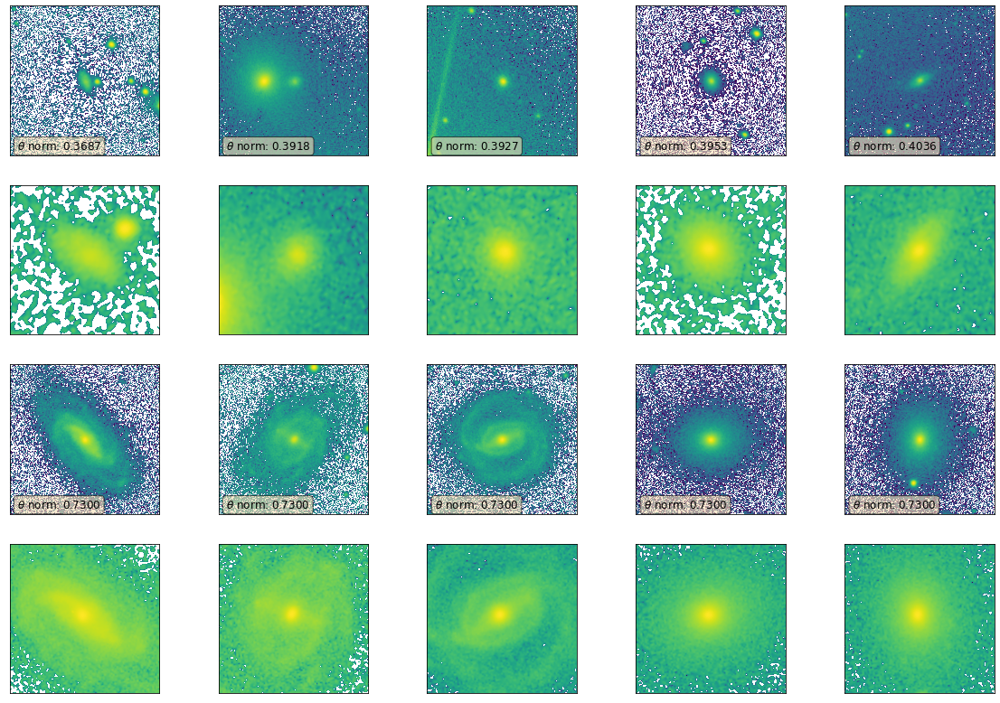

In [93]:
data_dir="/gpfs/loomis/scratch60/urry/ag2422/sdss/"
#ggt16b_1
model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/22/6d10a3ebf36146309604232ead44f7bc/artifacts/ggt16b-balanced-dev-6d10a3ebf36146309604232ead44f7bc.pt"
model_type="ggt"

show_least_and_most_aggresive_crops(data_dir=data_dir,slug="balanced-xl",split="devel",label_col="bt_g",cutout_size=167,
                                    model_path=model_path,model_type=model_type,parallel=True, channels=1, n_out=1,
                                    normalize=True,repeat_dims=False,n_workers=4,batch_size=36)

There are two interesting things that come out of this experiment:-
* **When using a GGT model on SDSS data trying to predict BTR, the STN network performs appropriately aggresive cropping.**

*  **We see $\theta_{11,12,21,22}$ all have non-zero values. It seems that the cropping is being performed by other parameters than what was being done for the HSC data. i.e. $\theta_{12,21}$ seem to be controlling the amount of crop. Also, it seems that some rotations are also involved in the process.**

# ggt16a runs 

I had initiated a bumch of runs with the VGG-16 model on the SDSS (real) data in order to try to recreate Amrit's cropping results. Let's now look at the results of these runs! 

**None of the runs converge very well**. (they do give MAEs very close to that of ggt16b by the way) But, I pick ggt16a_1 to work with here.  

[2021-09-22 16:01:05,507] Generating PyTorch tensors from FITS files...
100%|██████████| 5628/5628 [00:00<00:00, 86697.75it/s]
[2021-09-22 16:01:05,575] Preloading 5628 tensors...
100%|██████████| 5628/5628 [00:01<00:00, 4570.21it/s]
[2021-09-22 16:01:10,379] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b5949769150>


[2021-09-22 16:01:55,475] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b5948109048>



Lowest 2 and Highest 2 Theta Arrays
tensor([[ 0.9610, -0.0229, -0.0044, -0.0593,  0.8957,  0.0058]],
       device='cuda:0')
tensor([[ 0.9613, -0.0233, -0.0045, -0.0587,  0.8953,  0.0059]],
       device='cuda:0')
tensor([[ 0.9644, -0.0240,  0.0036, -0.0566,  0.8973,  0.0125]],
       device='cuda:0')
tensor([[ 0.9643, -0.0240,  0.0032, -0.0566,  0.8974,  0.0120]],
       device='cuda:0')


[2021-09-22 16:01:57,689] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2b5948109048>


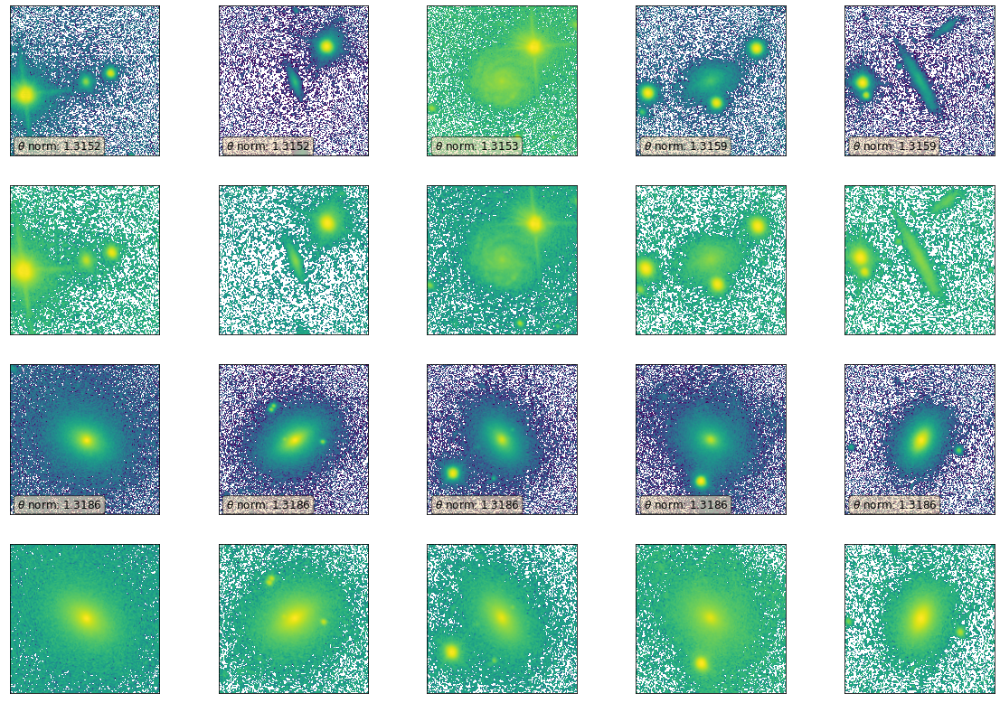

In [95]:
data_dir="/gpfs/loomis/scratch60/urry/ag2422/sdss/"
#ggt16a_1
model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/21/f349df95ef214e9c855dcf589fa31b00/artifacts/ggt16a-balanced-dev-f349df95ef214e9c855dcf589fa31b00.pt"
model_type="vgg16_w_stn"

show_least_and_most_aggresive_crops(data_dir=data_dir,slug="balanced-xl",split="devel",label_col="bt_g",cutout_size=167,
                                    model_path=model_path,model_type=model_type,parallel=True, channels=3, n_out=1,
                                    normalize=True,repeat_dims=True,n_workers=4,batch_size=36)

There are two interesting things that come out of this experiment:-
*  **It seems that the cropping is being performed by other parameters. I.E. $\theta_{12,21}$ seem to be controlling the amount of crop. Also, it seems that some rotations are also involved in the process.**
*  **The results of the VGG model here is very similar to what we see happening for the HSC data; i.e. the variation in the theta parameters is very low.**

## ggt15_4

From the above results we can see that the STN-GGT model when working on the SDSS data produces good cutouts; while the STN-VGG model doesn't produce good results.

So, let's see what the STN-GGT model looks like when working on the HSC data. Note that we know this model was trained directly on HSC data (with Simard labels); and we know that it converged because it achieves roughly the same accuracy as that achieved by the VGG trained on simulations 

[2021-09-22 17:25:42,751] Generating PyTorch tensors from FITS files...
100%|██████████| 1000/1000 [00:00<00:00, 64942.39it/s]
[2021-09-22 17:25:42,768] Preloading 1000 tensors...
100%|██████████| 1000/1000 [00:00<00:00, 2899.63it/s]
[2021-09-22 17:25:43,911] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2aac3cff9938>


[2021-09-22 17:27:49,093] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2aac3cff97d8>



Lowest 2 and Highest 2 Theta Arrays
tensor([[ 8.2054e-01, -3.3937e-02,  3.1070e-03,  3.3136e-02,  8.1630e-01,
          7.4121e-04]], device='cuda:0')
tensor([[ 8.2057e-01, -3.3950e-02,  3.0514e-03,  3.3050e-02,  8.1637e-01,
          8.1425e-04]], device='cuda:0')
tensor([[ 0.8209, -0.0340,  0.0030,  0.0330,  0.8166,  0.0010]],
       device='cuda:0')
tensor([[ 0.8209, -0.0340,  0.0030,  0.0330,  0.8166,  0.0010]],
       device='cuda:0')


[2021-09-22 17:27:49,615] Using 2 GPUs <generator object discover_devices.<locals>.<genexpr> at 0x2aac3cff9d00>


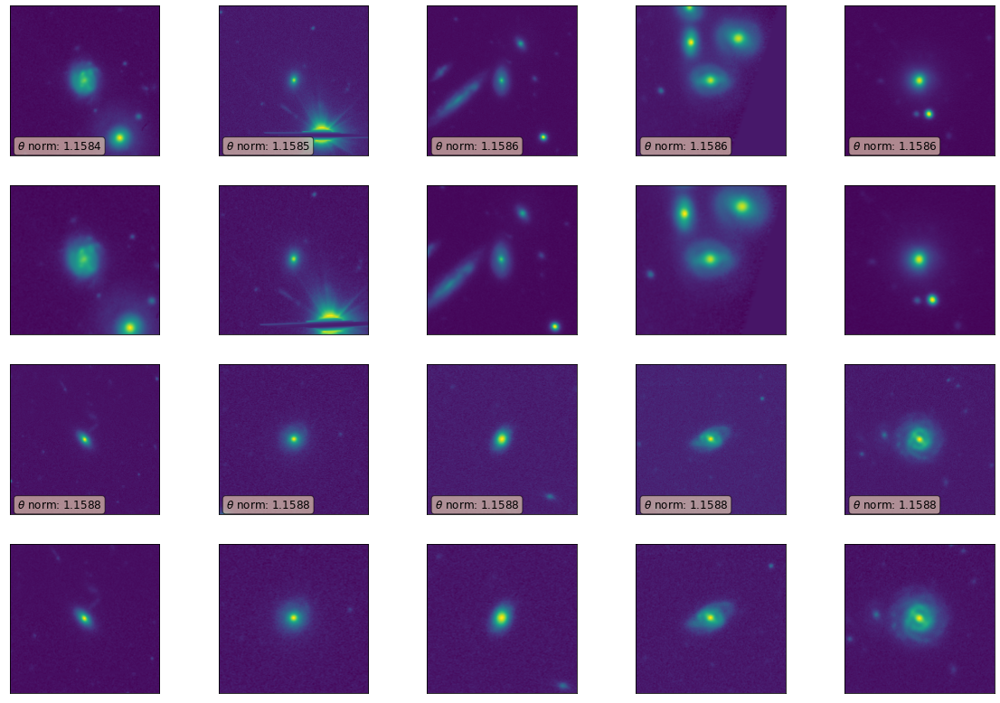

In [15]:
data_dir="/gpfs/loomis/project/urry/ag2422/git_repos/ggt/data/hsc_real/hsc_0_025_second_xmatch_simard/"
#ggt15_4
model_path="/gpfs/loomis/project/urry/ag2422/galnet_reg_runs/ggt_runs/mlruns/18/1f88af757b864346b71fe955320a0203/artifacts/ggt15-balanced-xl-1f88af757b864346b71fe955320a0203.pt"
model_type="ggt"

show_least_and_most_aggresive_crops(data_dir=data_dir,slug="balanced-xl",split="devel",label_col="(B/T)g",cutout_size=239,
                                    model_path=model_path,model_type=model_type,parallel=True, channels=1, n_out=1,
                                    normalize=True,repeat_dims=False,n_workers=4,batch_size=36,logcolors=False)

**But, ALAS! This is not the case. For the HSC data, a GGT model trained to predict only BT, doesn't do as good as of a job. In fact, it again is as less aggressive as the rest of the HSC models**